## UMAP 2024

Data Analysis about Attractive Image Judgement to answer the fellow research questions:

    - How do user demographics, food knowledge, cooking skills contribute to the user perception of food images ?
    
    - To what extent different human food choice factors influence the user perception ?

    - Why do ratings are given, what determines the ratings of an individual, interpretation of what people are ratings?

In [154]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import math

import warnings
warnings.filterwarnings('ignore')
%load_ext autoreload 
%autoreload

import sys
sys.path.insert(0,'./rd_data')
from rd_data import *

import statsmodels.formula.api as smf
import statsmodels.api as sm


palette = 'Set2'
sns.set_style("darkgrid")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


- read data

In [155]:
personal_info = pd.read_csv('./csv/Personal_info.csv')
sfd_cc = pd.read_csv('./csv/Subjective_knowledge.csv')
ratings = pd.read_csv('./csv/Ratings_judgment.csv')
factors = pd.read_csv('./csv/Factors.csv')

In [156]:
personal_info = personal_info[['id','age','country','education','gender']]
sfd_cc = sfd_cc[['person','FK_9','FK_10','FK_11', 'FK_12', 'CS_9',
                        'CS_10', 'CS_11', 'CS_12', 'CS_13', 'CS_14']]
ratings = ratings[['person', 'rating', 'recipes', 'judging']]
factors = factors[['id', 'person', 'appearance', 'taste', 'healthiness', 'familiarity']]

In [157]:
personal_info

,id,age,country,education,gender
0,14,b18_24,PL,High_school,Male
1,15,b18_24,ZA,High_school,Female
2,16,b25_35,GB,MSc,Female
3,17,b35_45,ES,BA,Female
4,18,b35_45,ES,BA,Male
...,...,...,...,...,...
197,214,bover_55,GB,High_school,Female
198,215,b35_45,GB,BA,Male
199,216,b45_55,GB,High_school,Female
200,217,b35_45,GB,High_school,Male


In [158]:
personal_info.gender.value_counts(normalize=True)

gender
Male              0.653465
Female            0.341584
refuse_to_disc    0.004950
Name: proportion, dtype: float64

### Demographics 

In [159]:
# Age
personal_info.age.value_counts(normalize=True)

age
b25_35      0.391089
b18_24      0.237624
b35_45      0.202970
b45_55      0.113861
bover_55    0.054455
Name: proportion, dtype: float64

In [160]:
# Education
personal_info.education.value_counts(normalize=True)

education
High_school         0.396040
BA                  0.391089
MSc                 0.163366
Doctorate           0.024752
Less_high_school    0.014851
Not                 0.009901
Name: proportion, dtype: float64

In [161]:
# gender 
personal_info.gender.value_counts(normalize=True)

gender
Male              0.653465
Female            0.341584
refuse_to_disc    0.004950
Name: proportion, dtype: float64

- demographics and ratings distribution

In [162]:
ratings_dest = ratings.merge(personal_info, right_on='id', left_on='person')
ratings_dest.head()

,person,rating,recipes,judging,id,age,country,education,gender
0,16,7,Couscous with Olives and Sun-Dried Tomato,It looks colourful,16,b25_35,GB,MSc,Female
1,16,7,Kelly's Black Bean Salad,Has ingredients i enjoy,16,b25_35,GB,MSc,Female
2,16,2,Peanut Butter Candy,Dont like peanut butter,16,b25_35,GB,MSc,Female
3,16,1,Wisconsin Five-Cheese Bake,too carby,16,b25_35,GB,MSc,Female
4,16,7,Apple Goat Cheese Bruschetta,includes food i like,16,b25_35,GB,MSc,Female


(array([196., 246.,   0., 294.,   0., 323., 430.,   0., 373., 320.]),
 array([1. , 1.6, 2.2, 2.8, 3.4, 4. , 4.6, 5.2, 5.8, 6.4, 7. ]),
 <BarContainer object of 10 artists>)

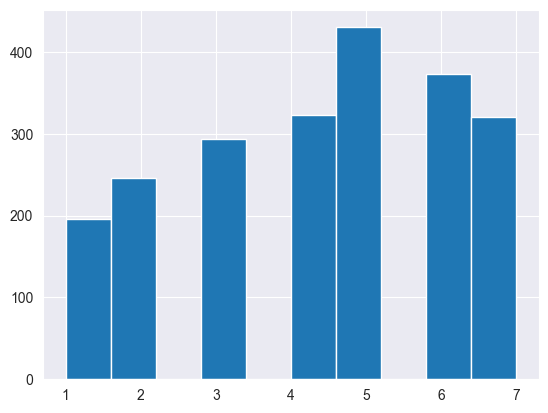

In [163]:
plt.hist( ratings_dest.rating)

In [164]:
ratings_dest.rating.mean()

4.349220898258478

In [165]:
ratings_dest.rating.std()

1.864002201454582

In [166]:
ratings_dest.rating.median()

5.0

In [167]:
avg_rating = ratings_dest.groupby('recipes')['rating'].std().reset_index()
avg_rating

,recipes,rating
0,120 Calorie Peach Pies,1.516575
1,Acorn Squash Ice Cream,1.641476
2,Adult Cherry Vanilla Frozen Yogurt,1.243163
3,Alla Checca,1.955550
4,Alysia's Basic Meat Lasagna,2.027588
...,...,...
196,Wisconsin Five-Cheese Bake,2.179449
197,Zesty Southern Pasta and Bean Salad,1.911687
198,Ziti Chicken and Broccoli,1.398412
199,Ziti and Eggplant,1.642245


(array([ 2.,  7., 22., 35., 38., 43., 31., 18.,  3.,  2.]),
 array([0.46291005, 0.6849472 , 0.90698435, 1.12902151, 1.35105866,
        1.57309581, 1.79513296, 2.01717012, 2.23920727, 2.46124442,
        2.68328157]),
 <BarContainer object of 10 artists>)

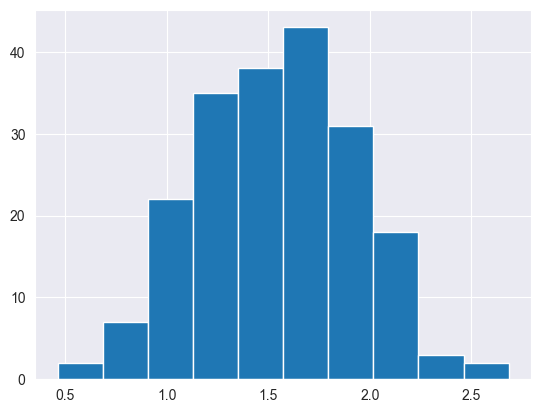

In [168]:
plt.hist( avg_rating.rating)

In [169]:
removed = avg_rating.loc[avg_rating.rating > 1.5]
remove = removed.recipes


(array([28., 22., 19., 19., 13.,  7.,  1.,  2.,  1.,  1.]),
 array([1.50151439, 1.61969111, 1.73786782, 1.85604454, 1.97422126,
        2.09239798, 2.2105747 , 2.32875142, 2.44692814, 2.56510485,
        2.68328157]),
 <BarContainer object of 10 artists>)

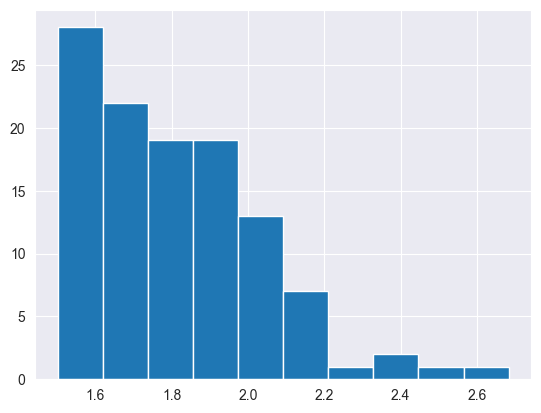

In [170]:
plt.hist(avg_rating.loc[avg_rating.rating > 1.5].rating)

In [171]:
removed_ = ratings_dest.merge(remove, on='recipes')
removed_.shape

(1245, 9)

In [172]:
avg_removed = removed_.groupby('recipes')['rating'].mean().reset_index()
avg_removed

,recipes,rating
0,120 Calorie Peach Pies,3.600000
1,Acorn Squash Ice Cream,4.777778
2,Alla Checca,5.142857
3,Alysia's Basic Meat Lasagna,3.888889
4,Anise Almond Biscotti,4.200000
...,...,...
108,Vegetarian Slow Cooker Meal,5.142857
109,Wisconsin Five-Cheese Bake,4.250000
110,Zesty Southern Pasta and Bean Salad,4.636364
111,Ziti and Eggplant,4.166667


Text(0, 0.5, 'Count')

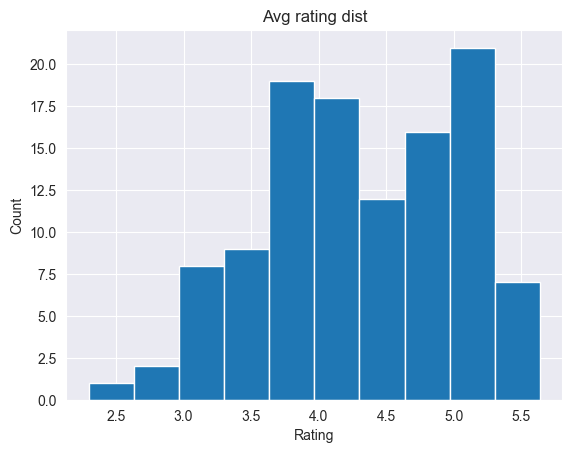

In [175]:
plt.hist(avg_removed.rating)
plt.title('Avg rating dist')
plt.xlabel('Rating')
plt.ylabel('Count')

- Age and ratings

In [59]:
age_rating = ratings_dest.groupby('age')['rating'].mean().reset_index()
age_rating

,age,rating
0,b18_24,4.392857
1,b25_35,4.200000
2,b35_45,4.461009
3,b45_55,4.599206
4,bover_55,4.316667


- education and ratings

In [60]:
education_rating = ratings_dest.groupby('education')['rating'].mean().reset_index()
education_rating

,education,rating
0,BA,4.337444
1,Doctorate,4.333333
2,High_school,4.397343
3,Less_high_school,3.750000
4,MSc,4.246032
5,Not,5.083333


In [61]:
gender_rating = ratings_dest.groupby('gender')['rating'].mean().reset_index()
gender_rating

,gender,rating
0,Female,4.427632
1,Male,4.300000
2,refuse_to_disc,5.166667


## Food Knowledge and cooking experience

In [62]:
sfd_cc.replace({'Strongly_Disagree':1, 'Disagree':2, 'Neutral':3, 'Agree':4, 'Strongly_Agree':5}, inplace=True)

In [63]:
sfd_cc['SFD'] = sfd_cc[['FK_9','FK_10','FK_11','FK_12']].mean(axis=1)
sfd_cc['CC'] = sfd_cc[['CS_9','CS_10','CS_11','CS_12','CS_13','CS_14']].mean(axis=1)


In [64]:
sfd_level_mean = sfd_cc.SFD.mean()
cc_level_mean = sfd_cc.CC.mean()
sfd_cc['sfd_level'] = 1
sfd_cc['cc_level'] = 1


In [65]:
sfd_cc.loc[sfd_cc['SFD'] < sfd_level_mean, 'sfd_level'] = 0
sfd_cc.loc[sfd_cc['CC'] < cc_level_mean, 'cc_level'] = 0
sfd_cc

,person,FK_9,FK_10,FK_11,FK_12,CS_9,CS_10,CS_11,CS_12,CS_13,CS_14,SFD,CC,sfd_level,cc_level
0,14,3,4,4,2,4,4,5,4,4,3,3.25,4.000000,0,0
1,15,4,4,3,3,4,5,5,5,5,5,3.50,4.833333,1,1
2,16,4,5,5,1,4,4,5,5,4,4,3.75,4.333333,1,1
3,18,4,4,4,2,4,4,3,4,5,5,3.50,4.166667,1,1
4,17,5,5,4,1,5,5,4,4,4,5,3.75,4.500000,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189,214,3,4,4,2,5,5,5,5,4,4,3.25,4.666667,0,1
190,215,3,4,4,2,4,4,5,4,5,4,3.25,4.333333,0,1
191,216,4,4,4,2,5,5,5,5,5,5,3.50,5.000000,1,1
192,217,4,4,4,2,5,4,4,4,4,4,3.50,4.166667,1,1


In [66]:
ratings_sfd = sfd_cc[['person','SFD','CC','sfd_level','cc_level']].merge(ratings, on='person')


In [67]:
ratings_sfd

,person,SFD,CC,sfd_level,cc_level,rating,recipes,judging
0,14,3.25,4.000000,0,0,3,Moist Holiday Honeycake,I don't like the design of this cookie
1,14,3.25,4.000000,0,0,6,Cottage Cheese Croquettes,It looks very tasty
2,14,3.25,4.000000,0,0,4,Pearl Couscous Salad,"I don't like this type of food, but it looks ok"
3,14,3.25,4.000000,0,0,6,Fruit Skewers with Apple Cinnamon Dipping Sauce,Very nicely arranged fruit. The rating could b...
4,14,3.25,4.000000,0,0,6,Butter Mochi Cake,It looks very tasty
...,...,...,...,...,...,...,...,...
2165,218,3.25,3.833333,0,0,2,Baked Apples,Not my thing
2166,218,3.25,3.833333,0,0,4,Chicken Pasta I,not an appealing photo but has the potential t...
2167,218,3.25,3.833333,0,0,2,Sweet Potato and Avocado Salad,a bit boring
2168,218,3.25,3.833333,0,0,4,Deviled Eggs with Dill and Prosciutto,"good photo, looks appealing"


In [68]:
ratings_levels = ratings_sfd.groupby(['person','sfd_level','cc_level'])['rating'].mean().reset_index()

- knowledge level

In [69]:
sfd_level_ratings = ratings_levels.groupby(['sfd_level'])['rating'].mean()
cc_level_ratings = ratings_levels.groupby(['cc_level'])['rating'].mean()


In [70]:
sfd_level_ratings

sfd_level
0    4.311056
1    4.386301
Name: rating, dtype: float64

<Axes: xlabel='sfd_level', ylabel='rating'>

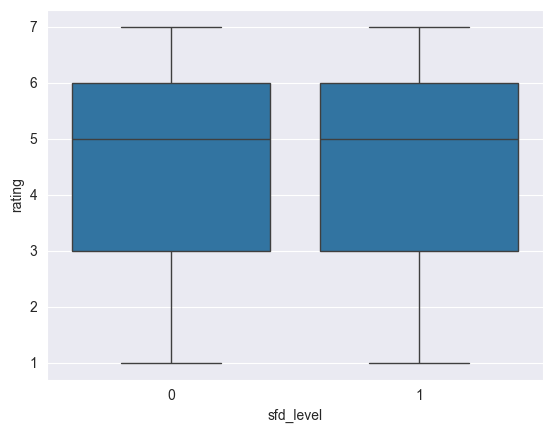

In [71]:
sns.boxplot(y=ratings_sfd['rating'], x=ratings_sfd['sfd_level'])

- cooking experience

In [72]:
cc_level_ratings

cc_level
0    4.182489
1    4.475789
Name: rating, dtype: float64

<Axes: xlabel='cc_level', ylabel='rating'>

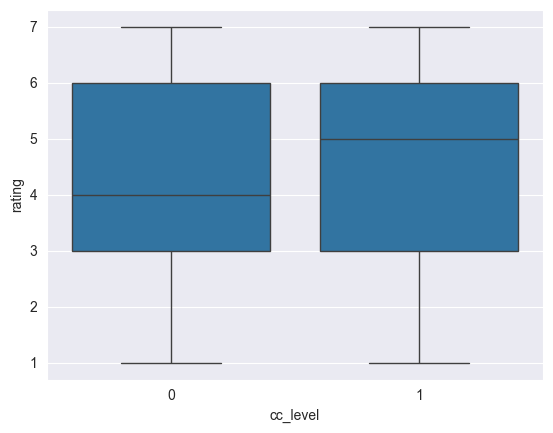

In [73]:
sns.boxplot(y=ratings_sfd['rating'], x=ratings_sfd['cc_level'])

## User profiles and ratings

In [74]:
profiles = pd.read_csv('./csv/profile.csv')
profiles = profiles.drop(columns=['id','title'])

- Recipe Web usage and ratings

In [75]:
profiles.RecipeWebUsage.value_counts(normalize=True).reset_index()

,RecipeWebUsage,proportion
0,Monthly,0.630208
1,Weekly,0.354167
2,Daily,0.015625


In [76]:
profile_ratings = profiles.merge(ratings, on='person')
profile_ratings.head()

,person,Height,Weight,RecipeWebUsage,HomeCook,CookingExp,EatingGoals,Depression,PhysicalActivity,SleepHours,CookingTime,rating,recipes,judging
0,14,183,69,Weekly,Weekly,Medium,Gain Weight,Somewhat,Average (=6h),‚â§7h,‚â§30min,3,Moist Holiday Honeycake,I don't like the design of this cookie
1,14,183,69,Weekly,Weekly,Medium,Gain Weight,Somewhat,Average (=6h),‚â§7h,‚â§30min,6,Cottage Cheese Croquettes,It looks very tasty
2,14,183,69,Weekly,Weekly,Medium,Gain Weight,Somewhat,Average (=6h),‚â§7h,‚â§30min,4,Pearl Couscous Salad,"I don't like this type of food, but it looks ok"
3,14,183,69,Weekly,Weekly,Medium,Gain Weight,Somewhat,Average (=6h),‚â§7h,‚â§30min,6,Fruit Skewers with Apple Cinnamon Dipping Sauce,Very nicely arranged fruit. The rating could b...
4,14,183,69,Weekly,Weekly,Medium,Gain Weight,Somewhat,Average (=6h),‚â§7h,‚â§30min,6,Butter Mochi Cake,It looks very tasty


<Axes: xlabel='rating', ylabel='RecipeWebUsage'>

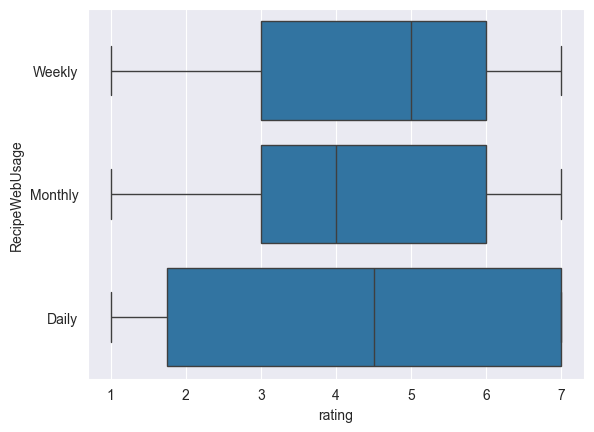

In [77]:
sns.boxplot(x=profile_ratings['rating'], y=profile_ratings['RecipeWebUsage'])

In [78]:
recipeWebUsage_ratings = profile_ratings.groupby('RecipeWebUsage')['rating'].mean().reset_index()
recipeWebUsage_ratings

,RecipeWebUsage,rating
0,Daily,4.444444
1,Monthly,4.237263
2,Weekly,4.517105


- Eating goals and ratings 

In [79]:
eating_ratings = profile_ratings.groupby('EatingGoals')['rating'].mean().reset_index()
eating_ratings

,EatingGoals,rating
0,Gain Weight,4.421296
1,Lose Weight,4.350000
2,No Goal,4.312849


<Axes: xlabel='EatingGoals', ylabel='rating'>

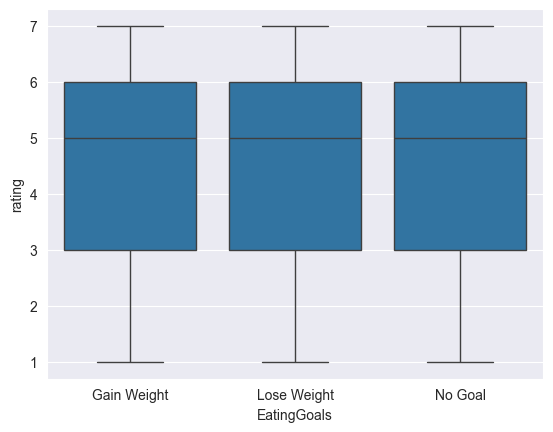

In [80]:
sns.boxplot(y=profile_ratings['rating'], x=profile_ratings['EatingGoals'])

- Physical Activity

In [81]:
Activity_ratings = profile_ratings.groupby('PhysicalActivity')['rating'].mean().reset_index()
Activity_ratings

,PhysicalActivity,rating
0,A lot (>9h),4.365385
1,Average (=6h),4.340249
2,Not enough (<3h),4.319783


<Axes: xlabel='PhysicalActivity', ylabel='rating'>

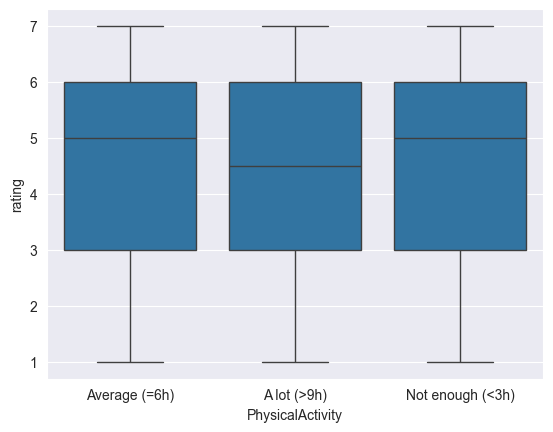

In [82]:
sns.boxplot(y=profile_ratings['rating'], x=profile_ratings['PhysicalActivity'])

In [83]:
profile_ratings.columns

Index(['person', 'Height', 'Weight', 'RecipeWebUsage', 'HomeCook',
       'CookingExp', 'EatingGoals', 'Depression', 'PhysicalActivity',
       'SleepHours', 'CookingTime', 'rating', 'recipes', 'judging'],
      dtype='object')

- Depression and ratings

In [84]:
profile_ratings.Depression.value_counts(normalize=True).reset_index()

,Depression,proportion
0,Not at all,0.544700
1,Somewhat,0.361290
2,Quite a lot,0.094009


In [85]:
depression_ratings = profile_ratings.groupby('Depression')['rating'].mean().reset_index()
depression_ratings

,Depression,rating
0,Not at all,4.378173
1,Quite a lot,4.401961
2,Somewhat,4.262755


<Axes: xlabel='Depression', ylabel='rating'>

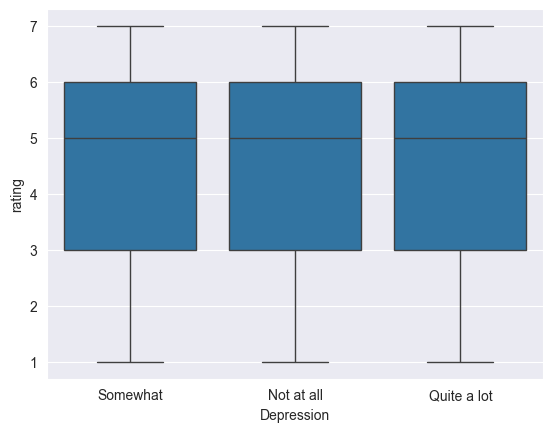

In [86]:
sns.boxplot(y=profile_ratings['rating'], x=profile_ratings['Depression'])

- Sleep hours and ratings

In [87]:
profile_ratings.SleepHours.replace({'<7':'≤7','>9':'≥9'}, inplace=True)

profile_ratings.SleepHours.value_counts(normalize=True).reset_index()

,SleepHours,proportion
0,7-9h,0.673733
1,‚â§7h,0.315207
2,‚â•9h,0.011060


In [88]:
sleep_ratings = profile_ratings.groupby('SleepHours')['rating'].mean().reset_index()
sleep_ratings

,SleepHours,rating
0,7-9h,4.357729
1,‚â§7h,4.293860
2,‚â•9h,4.458333


<Axes: xlabel='SleepHours', ylabel='rating'>

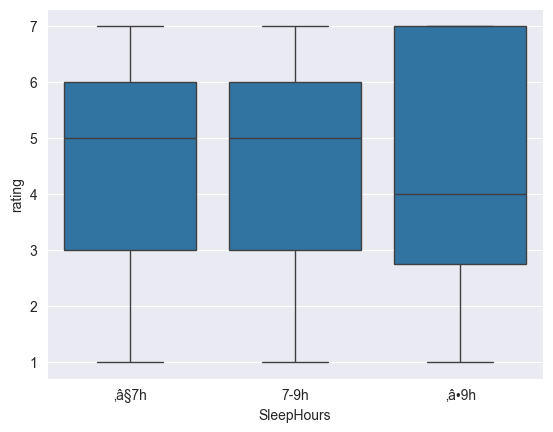

In [89]:
sns.boxplot(y=profile_ratings['rating'], x=profile_ratings['SleepHours'])

In [100]:
profile_ratings.columns

Index(['person', 'Height', 'Weight', 'RecipeWebUsage', 'HomeCook',
       'CookingExp', 'EatingGoals', 'Depression', 'PhysicalActivity',
       'SleepHours', 'CookingTime', 'rating', 'recipes', 'judging'],
      dtype='object')

- Cooking time and ratings

In [101]:
profile_ratings.replace({'‚â§30min':'≤30min', '‚â•60min':'≥60min'}, inplace=True)
profile_ratings.CookingTime.value_counts(normalize=True).reset_index()

,CookingTime,proportion
0,30-60min,0.604608
1,≤30min,0.259908
2,≥60min,0.135484


In [102]:
Cooking_Time = profile_ratings.groupby('CookingTime')['rating'].mean().reset_index()
Cooking_Time

,CookingTime,rating
0,30-60min,4.361280
1,≤30min,4.175532
2,≥60min,4.551020


<Axes: xlabel='CookingTime', ylabel='rating'>

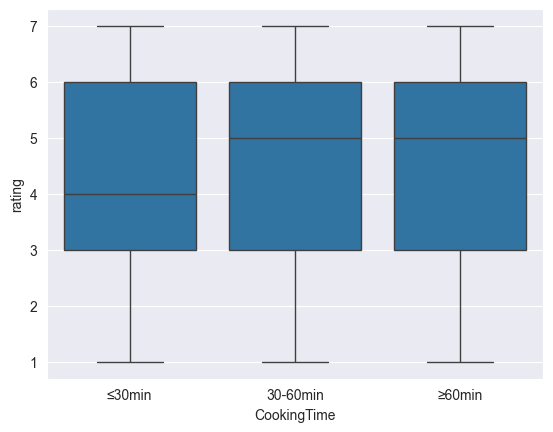

In [103]:
sns.boxplot(y=profile_ratings['rating'], x=profile_ratings['CookingTime'])

## All Data

In [104]:
all_data = personal_info.merge(sfd_cc.merge(ratings.merge(factors, 
                                                          on='person'), 
                                                          on='person'), 
                                                          left_on='id',right_on='person')

In [105]:
all_data = all_data.merge(profiles, left_on='person', right_on='person')

In [106]:
all_data[['RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression',
          'PhysicalActivity','SleepHours','CookingTime']].value_counts()

RecipeWebUsage  HomeCook  CookingExp  EatingGoals  Depression   PhysicalActivity  SleepHours  CookingTime
Monthly         Daily     Medium      No Goal      Not at all   Average (=6h)     7-9h        30-60min       48
Weekly          Daily     Medium      No Goal      Not at all   A lot (>9h)       7-9h        30-60min       36
Monthly         Daily     Low         No Goal      Not at all   Average (=6h)     7-9h        30-60min       36
                Weekly    Medium      No Goal      Not at all   Average (=6h)     ‚â§7h       30-60min       36
Weekly          Weekly    Medium      No Goal      Not at all   Average (=6h)     7-9h        30-60min       36
                                                                                                             ..
Monthly         Monthly   Low         No Goal      Not at all   Average (=6h)     7-9h        ‚â§30min       12
                                                                A lot (>9h)       7-9h        ‚â§30min       1

In [107]:
all_data.replace({
    'Monthly':1, 'Weekly':2, 'Daily':3,
    'No Goal':1, 'Lose Weight':2, 'Gain Weight':3,
    'Very_Low':1, 'Low':2, 'Medium':3, 'High':4, 'Very_High':5,
    '30-60min':2, '‚â§30min':1, '‚â•60min':3,
    '7-9h':2,'‚â§7h':1, '‚â•9h':3,
    'Average (=6h)':1, 'A lot (>9h)':2, 'Not enough (<3h)':3,
    'Not at all':1,'Somewhat':2,'Quite a lot':3,
}, inplace=True)

In [108]:
# all_data.drop(columns={'person'}, inplace=True)

In [109]:
all_data.to_csv('./csv/all_data.csv', index=False)

In [110]:
all_data.groupby('recipes')['rating'].mean().reset_index()

,recipes,rating
0,120 Calorie Peach Pies,3.600000
1,Acorn Squash Ice Cream,4.777778
2,Adult Cherry Vanilla Frozen Yogurt,5.727273
3,Alla Checca,5.142857
4,Alysia's Basic Meat Lasagna,3.888889
...,...,...
196,Wisconsin Five-Cheese Bake,4.250000
197,Zesty Southern Pasta and Bean Salad,4.636364
198,Ziti Chicken and Broccoli,4.800000
199,Ziti and Eggplant,4.166667


In [111]:
all_data.taste.value_counts()

taste
Agree                1036
Strongly_Agree        762
Neutral               204
Disagree               96
Strongly_Disagree      24
Name: count, dtype: int64

In [112]:
all_data.replace({'Agree':4,'Strongly_Agree':5,'Neutral':3, 'Disagree':2, 'Strongly_Disagree':1}, inplace=True)

In [113]:
all_data.head()

,id_x,age,country,education,gender,person,FK_9,FK_10,FK_11,FK_12,...,Height,Weight,RecipeWebUsage,HomeCook,CookingExp,EatingGoals,Depression,PhysicalActivity,SleepHours,CookingTime
0,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,183,69,2,2,3,3,2,1,1,1
1,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,183,69,2,2,3,3,2,1,1,1
2,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,183,69,2,2,3,3,2,1,1,1
3,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,183,69,2,2,3,3,2,1,1,1
4,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,183,69,2,2,3,3,2,1,1,1


In [114]:
all_data.to_csv('./csv/all_data.csv', index=False)

In [240]:
## user average ratings 
all_data['user_avg_ratings'] = all_data.groupby('recipes')['rating'].transform('mean')

# groupby('id')['rating'].mean()

In [245]:
all_data.loc[all_data.recipes== '120 Calorie Peach Pies'][['user_avg_ratings','recipes']]

,user_avg_ratings,recipes
39,3.6,120 Calorie Peach Pies
260,3.6,120 Calorie Peach Pies
1444,3.6,120 Calorie Peach Pies
1457,3.6,120 Calorie Peach Pies
1974,3.6,120 Calorie Peach Pies


In [248]:
all_data_unique = all_data.drop_duplicates(subset=['recipes'])
all_data_unique.drop(columns={'rating','judging'}, inplace=True)

In [251]:
all_data_unique.to_csv('./csv/all_unique.csv',index=False)

In [252]:
all_data_unique.recipes

0                                Moist Holiday Honeycake
1                              Cottage Cheese Croquettes
2                                   Pearl Couscous Salad
3        Fruit Skewers with Apple Cinnamon Dipping Sauce
4                                      Butter Mochi Cake
                             ...                        
507             Grandmother's Polish Cabbage and Noodles
518    Schwabischer Kartoffelsalat (Schwabish Potato ...
523                Turkey Ragu with Fontina and Parmesan
537                                          Pasticiotti
632                                       Broccoli Salad
Name: recipes, Length: 201, dtype: object

In [253]:
unique_gender = all_data_unique.loc[all_data_unique.gender != 'refuse_to_disc']

In [254]:
unique_gender.gender.value_counts()

gender
Male      122
Female     79
Name: count, dtype: int64

In [255]:
unique_gender.to_csv('unique_gender.csv', index=False)

### image features and ratings

In [256]:
image_feature = pd.read_csv('./csv/image_features_ratings.csv')
image_feature.drop(['rating'], inplace=True, axis=1)

In [263]:
image_feature.columns

Index(['recipes', 'brightness', 'sharpness', 'contrast', 'colourfulness',
       'entropy', 'rgbContrast', 'sharpnessVariation', 'saturation',
       'saturationVariation', 'naturalness', 'attractiveness'],
      dtype='object')

In [264]:
image_features_user_data = all_data_unique.merge(image_feature, on='recipes')
image_features_user_data

,id_x,age,country,education,gender,person,FK_9,FK_10,FK_11,FK_12,...,sharpness,contrast,colourfulness,entropy,rgbContrast,sharpnessVariation,saturation,saturationVariation,naturalness,attractiveness
0,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.130293,0.089280,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0
1,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.071842,0.039027,0.305079,7.609357,0.152053,0.125964,0.381916,0.201674,0.949144,1
2,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.151276,0.047129,0.278437,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0
3,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.174287,0.063115,0.305252,7.790298,0.235713,0.364918,0.213981,0.215746,0.757956,1
4,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.057889,0.038757,0.256719,7.555311,0.146030,0.084506,0.275361,0.189840,0.889563,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,70,b18_24,PL,High_school,Male,70,3,1,2,4,...,0.072205,0.051718,0.177486,7.510296,0.168655,0.146972,0.157222,0.125274,0.702496,0
196,71,b35_45,GB,High_school,Male,71,4,4,4,2,...,0.094064,0.055482,0.185068,6.568757,0.186325,0.278147,0.154041,0.143021,0.826464,0
197,72,b35_45,US,High_school,Female,72,4,4,4,2,...,0.087312,0.063546,0.292639,7.813138,0.233955,0.158204,0.245889,0.172105,0.789120,1
198,73,bover_55,GB,BA,Female,73,4,4,4,2,...,0.160611,0.051713,0.106606,7.617414,0.163898,0.239055,0.086219,0.068567,0.552879,0


In [265]:
image_features_user_data[['recipes','user_avg_ratings']]

,recipes,user_avg_ratings
0,Moist Holiday Honeycake,3.833333
1,Cottage Cheese Croquettes,5.600000
2,Pearl Couscous Salad,4.166667
3,Fruit Skewers with Apple Cinnamon Dipping Sauce,5.538462
4,Butter Mochi Cake,5.000000
...,...,...
195,Grandmother's Polish Cabbage and Noodles,3.500000
196,Schwabischer Kartoffelsalat (Schwabish Potato ...,2.300000
197,Turkey Ragu with Fontina and Parmesan,5.333333
198,Pasticiotti,5.100000


- Define dummy variables for categorical data (dummy variable)

In [266]:
dummy_gender = pd.get_dummies(image_features_user_data.gender)
dummy_education = pd.get_dummies(image_features_user_data.education)
dummy_age = pd.get_dummies(image_features_user_data.age)

In [267]:
all_feature = image_features_user_data.join([dummy_gender, dummy_education, dummy_age])
all_feature

,id_x,age,country,education,gender,person,FK_9,FK_10,FK_11,FK_12,...,Female,Male,BA,High_school,MSc,b18_24,b25_35,b35_45,b45_55,bover_55
0,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,False,True,False,True,False,True,False,False,False,False
1,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,False,True,False,True,False,True,False,False,False,False
2,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,False,True,False,True,False,True,False,False,False,False
3,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,False,True,False,True,False,True,False,False,False,False
4,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,False,True,False,True,False,True,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,70,b18_24,PL,High_school,Male,70,3,1,2,4,...,False,True,False,True,False,True,False,False,False,False
196,71,b35_45,GB,High_school,Male,71,4,4,4,2,...,False,True,False,True,False,False,False,True,False,False
197,72,b35_45,US,High_school,Female,72,4,4,4,2,...,True,False,False,True,False,False,False,True,False,False
198,73,bover_55,GB,BA,Female,73,4,4,4,2,...,True,False,True,False,False,False,False,False,False,True


In [268]:
all_feature.loc[all_feature.Height < 0, 'Height'] = all_feature.loc[all_feature.Height < 0]['Height']*(-1)
all_feature.loc[all_feature.Weight < 0, 'Weight'] = all_feature.loc[all_feature.Weight < 0]['Weight']*(-1)

In [269]:
all_feature.loc[all_feature.Height == 0, 'Height'] = all_feature['Height'].mean()
all_feature.loc[all_feature.Weight == 0, 'Weight'] = all_feature['Weight'].mean()

In [270]:
all_feature['BMI'] = all_feature.Weight / ((all_feature['Height']/100)**2)

In [274]:
model_data = all_feature[['user_avg_ratings','SFD','CC', 'appearance', 'taste',
       'healthiness', 'familiarity',
       'RecipeWebUsage', 'HomeCook', 'CookingExp', 'EatingGoals', 'Depression',
       'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness',
       'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast',
       'sharpnessVariation', 'saturation', 'saturationVariation',
       'naturalness','Female', 'Male',
       'MSc', 'b18_24', 'b25_35', 'b35_45', 'b45_55', 'bover_55','BMI'
       ]]

In [277]:
# defining variables
x =  model_data.drop(['user_avg_ratings'], axis=1)
y = model_data.user_avg_ratings

- Without Dummy variables

In [356]:
data_d = all_feature.copy()

In [357]:
data_d.drop(['MSc', 'b18_24', 'b25_35', 'b35_45', 'b45_55', 'bover_55','Female', 'Male',
], axis=1, inplace=True)

In [358]:
# data_d.drop(['BA', 'Doctorate',
#        'High_school', 'Less_high_school','country'], axis=1, inplace=True)

-- Split the Age into two groups

-- split education into groups 

-- split gender into groups 

In [359]:
data_d.age.replace({'b25_35':1,'b18_24':1,'b35_45':1,'b18_24':1,'b45_55':0, 'bover_55':0}, inplace=True)
data_d.education.replace({'Less_high_school':0,'Not':0,'Doctorate':1,'MSc':1, 'High_school':1, 'BA':1}, inplace=True)
data_d.gender.replace({'Male':1,'Female':0,'refuse_to_disc':0}, inplace=True)

In [360]:
data_d.drop(['Height', 'Weight','recipes'], axis=1,inplace=True)

In [361]:
# defining variables
x =  data_d.drop(['user_avg_ratings'], axis=1)
y = data_d.user_avg_ratings

In [362]:
x.columns

Index(['id_x', 'age', 'country', 'education', 'gender', 'person', 'FK_9',
       'FK_10', 'FK_11', 'FK_12', 'CS_9', 'CS_10', 'CS_11', 'CS_12', 'CS_13',
       'CS_14', 'SFD', 'CC', 'sfd_level', 'cc_level', 'id_y', 'appearance',
       'taste', 'healthiness', 'familiarity', 'RecipeWebUsage', 'HomeCook',
       'CookingExp', 'EatingGoals', 'Depression', 'PhysicalActivity',
       'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast',
       'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation',
       'saturation', 'saturationVariation', 'naturalness', 'attractiveness',
       'BA', 'High_school', 'BMI'],
      dtype='object')

In [363]:
x.shape

(200, 47)

In [322]:
x.drop(['id_x','id_y','FK_9', 'FK_10', 'FK_11',
       'FK_12', 'CS_9', 'CS_10', 'CS_11', 'CS_12', 'CS_13', 'CS_14','sfd_level','cc_level',
       'brightness', 'sharpness', 'contrast',
       'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation',
       'saturation', 'saturationVariation', 'naturalness','person','country','BA', 'High_school'
       ], axis=1,inplace=True)

In [324]:
# x.drop(['recipes'], axis=1, inplace=True)

In [325]:
x.head()

,age,education,gender,SFD,CC,appearance,taste,healthiness,familiarity,RecipeWebUsage,HomeCook,CookingExp,EatingGoals,Depression,PhysicalActivity,SleepHours,CookingTime,attractiveness,BMI
0,1,1,1,3.25,4.0,4,5,1,4,2,2,3,3,2,1,1,1,0,20.60378
1,1,1,1,3.25,4.0,4,5,1,4,2,2,3,3,2,1,1,1,1,20.60378
2,1,1,1,3.25,4.0,4,5,1,4,2,2,3,3,2,1,1,1,0,20.60378
3,1,1,1,3.25,4.0,4,5,1,4,2,2,3,3,2,1,1,1,1,20.60378
4,1,1,1,3.25,4.0,4,5,1,4,2,2,3,3,2,1,1,1,1,20.60378


In [327]:
# with statsmodels
x = sm.add_constant(x) # adding a constant
 
model = sm.OLS(y, x.astype(float)).fit()
predictions = model.predict(x) 
 
print_model = model.summary()
print(print_model)

In [329]:
print(print_model)

### Only user features

In [264]:
x

,SFD,CC,appearance,taste,healthiness,familiarity,RecipeWebUsage,HomeCook,CookingExp,EatingGoals,...,High_school,Less_high_school,MSc,Not,b18_24,b25_35,b35_45,b45_55,bover_55,BMI
0,3.25,4.000000,4,5,1,4,2,2,3,3,...,1,0,0,0,1,0,0,0,0,20.603780
1,3.75,4.333333,4,4,5,5,1,3,3,2,...,0,0,1,0,0,1,0,0,0,17.647059
2,3.75,4.500000,4,4,3,5,2,3,4,2,...,0,0,0,0,0,0,1,0,0,20.796730
3,3.00,2.833333,4,5,2,4,1,3,2,1,...,0,0,0,0,0,1,0,0,0,18.513199
4,2.25,4.500000,4,5,2,4,2,3,3,3,...,0,0,0,0,1,0,0,0,0,18.255524
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164,3.25,4.333333,5,4,2,2,1,2,3,1,...,1,0,0,0,0,1,0,0,0,33.802055
165,3.25,3.000000,5,4,4,4,1,1,2,3,...,0,1,0,0,0,0,1,0,0,22.498174
166,3.00,3.500000,3,5,2,5,1,2,3,1,...,1,0,0,0,0,1,0,0,0,25.458066
167,3.25,4.333333,2,5,2,4,1,3,4,2,...,0,0,0,0,0,0,1,0,0,36.227509


In [240]:
x = x.drop(['appearance','taste','healthiness','familiarity', 'attractiveness'], axis=1)

In [ ]:
# with statsmodels
# x = sm.add_constant(x) # adding a constant
 
model = sm.OLS(y, x).fit()
predictions = model.predict(x) 

print_model = model.summary()
print(print_model)

In [ ]:
data_d.to_csv('data_without_dummy.csv', index=False)
model_data.to_csv('data_with_dummy.csv', index=False)

## User choice Factors

In [330]:
# defining variables
x =  data_d[['appearance','taste','healthiness','familiarity']]
y = data_d.user_avg_ratings

In [331]:
 
model = sm.OLS(y, x).fit()
predictions = model.predict(x) 
 
print_model = model.summary()
print(print_model)

In [332]:
print_model

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:       user_avg_ratings   R-squared (uncentered):                   0.937
Model:                            OLS   Adj. R-squared (uncentered):              0.935
Method:                 Least Squares   F-statistic:                              723.5
Date:                Wed, 03 Jan 2024   Prob (F-statistic):                   3.94e-116
Time:                        11:58:53   Log-Likelihood:                         -307.68
No. Observations:                 200   AIC:                                      623.4
Df Residuals:                     196   BIC:                                      636.6
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
appearance      0.7137      0.086      8.290      0.000       0.544       0.883
taste           0.2236      0.103      2.177      0.031       0.021       0.426
healthiness    -0.0240      0.060     -0.403      0.687      -0.141       0.093
familiarity     0.0795      0.066      1.206      0.229      -0.051       0.210
==============================================================================
Omnibus:                        6.224   Durbin-Watson:                   1.819
Prob(Omnibus):                  0.045   Jarque-Bera (JB):                6.396
Skew:                          -0.433   Prob(JB):                       0.0408
Kurtosis:                       2.865   Cond. No.                         12.2
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## Image features and ratings

In [349]:
image_features_all_user = all_data.merge(image_feature, on='recipes')
image_features_all_user

,id_x,age,country,education,gender,person,FK_9,FK_10,FK_11,FK_12,...,sharpness,contrast,colourfulness,entropy,rgbContrast,sharpnessVariation,saturation,saturationVariation,naturalness,attractiveness
0,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.130293,0.089280,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0
1,42,bover_55,ES,High_school,Male,42,4,4,4,2,...,0.130293,0.089280,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0
2,59,b18_24,PL,BA,Male,59,4,4,4,2,...,0.130293,0.089280,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0
3,74,b35_45,GB,High_school,Female,74,3,4,4,2,...,0.130293,0.089280,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0
4,90,b25_35,ZA,High_school,Male,90,3,4,4,2,...,0.130293,0.089280,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2104,157,b25_35,CZ,High_school,Male,157,2,3,2,4,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1
2105,161,b25_35,ZA,BA,Female,161,4,3,3,2,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1
2106,193,b45_55,GB,BA,Male,193,4,5,4,2,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1
2107,194,b35_45,US,BA,Male,194,3,4,4,2,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1


In [398]:
image_features_all_user.merge(remove, on='recipes')

,id_x,age,country,education,gender,person,FK_9,FK_10,FK_11,FK_12,...,sharpness,contrast,colourfulness,entropy,rgbContrast,sharpnessVariation,saturation,saturationVariation,naturalness,attractiveness
0,14,b18_24,PL,High_school,Male,14,3,4,4,2,...,0.151276,0.047129,0.278437,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0
1,20,b25_35,DE,BA,Female,20,4,3,3,2,...,0.151276,0.047129,0.278437,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0
2,31,b25_35,GB,MSc,Female,31,4,4,4,2,...,0.151276,0.047129,0.278437,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0
3,36,b18_24,GR,High_school,Male,36,4,5,4,1,...,0.151276,0.047129,0.278437,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0
4,60,b35_45,GB,BA,Female,60,4,4,4,1,...,0.151276,0.047129,0.278437,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1194,157,b25_35,CZ,High_school,Male,157,2,3,2,4,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1
1195,161,b25_35,ZA,BA,Female,161,4,3,3,2,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1
1196,193,b45_55,GB,BA,Male,193,4,5,4,2,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1
1197,194,b35_45,US,BA,Male,194,3,4,4,2,...,0.117988,0.086671,0.187165,7.739853,0.278728,0.327673,0.144424,0.140552,0.719590,1


In [334]:
x = image_features_all_user[['brightness', 'sharpness', 'contrast',
       'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation',
       'saturation', 'saturationVariation', 'naturalness']]
y = image_features_all_user.rating

In [346]:
x_basic_features = x
y_basic_features = y

In [347]:
# with statsmodels
x = sm.add_constant(x) # adding a constant
 
model = sm.OLS(y, x).fit()
predictions = model.predict(x) 
 
print_model = model.summary()
print(print_model)

## Multi-level linear models

- Data normalization

In [279]:
x.drop(['FK_9', 'FK_10', 'FK_11', 'FK_12', 'CS_9',
       'CS_10', 'CS_11', 'CS_12', 'CS_13', 'CS_14'], axis=1, inplace=True)

In [281]:
x.drop(['id_y'], axis=1, inplace=True)

In [282]:
x.drop(['sfd_level','cc_level'], axis=1, inplace=True)

In [345]:
x.head()

,const,brightness,sharpness,contrast,colourfulness,entropy,rgbContrast,sharpnessVariation,saturation,saturationVariation,naturalness
0,1.0,0.382196,0.130293,0.08928,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163
1,1.0,0.382196,0.130293,0.08928,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163
2,1.0,0.382196,0.130293,0.08928,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163
3,1.0,0.382196,0.130293,0.08928,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163
4,1.0,0.382196,0.130293,0.08928,0.136704,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163


In [340]:
y

0       3
1       5
2       3
3       4
4       2
       ..
2104    7
2105    6
2106    6
2107    2
2108    3
Name: rating, Length: 2109, dtype: int64

In [341]:
from sklearn.preprocessing import MinMaxScaler
import HLR


## Data of HLR

In [395]:
x

,id_x,age,country,education,gender,person,FK_9,FK_10,FK_11,FK_12,...,entropy,rgbContrast,sharpnessVariation,saturation,saturationVariation,naturalness,attractiveness,BA,High_school,BMI
0,14,1,PL,1,1,14,3,4,4,2,...,7.010506,0.261178,0.173662,0.165825,0.087852,0.695163,0,False,True,20.603780
1,14,1,PL,1,1,14,3,4,4,2,...,7.609357,0.152053,0.125964,0.381916,0.201674,0.949144,1,False,True,20.603780
2,14,1,PL,1,1,14,3,4,4,2,...,7.712003,0.158284,0.208101,0.324170,0.165717,0.837176,0,False,True,20.603780
3,14,1,PL,1,1,14,3,4,4,2,...,7.790298,0.235713,0.364918,0.213981,0.215746,0.757956,1,False,True,20.603780
4,14,1,PL,1,1,14,3,4,4,2,...,7.555311,0.146030,0.084506,0.275361,0.189840,0.889563,1,False,True,20.603780
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,70,1,PL,1,1,70,3,1,2,4,...,7.510296,0.168655,0.146972,0.157222,0.125274,0.702496,0,False,True,18.699781
196,71,1,GB,1,1,71,4,4,4,2,...,6.568757,0.186325,0.278147,0.154041,0.143021,0.826464,0,False,True,26.122449
197,72,1,US,1,0,72,4,4,4,2,...,7.813138,0.233955,0.158204,0.245889,0.172105,0.789120,1,False,True,28.731747
198,73,0,GB,1,0,73,4,4,4,2,...,7.617414,0.163898,0.239055,0.086219,0.068567,0.552879,0,True,False,26.291724


### All features

In [2]:
X = [
      x[['age']], x[['age','education']], 
      x[['age','education','gender']],
      x[['age','education','gender','SFD']],
      x[['age','education','gender','SFD','CC']],
      x[['age','education','gender','SFD','CC','appearance']],
      x[['age','education','gender','SFD','CC','appearance','taste']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime']],
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime','BMI']],
 
     
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast']],
     
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation', 'saturation']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation', 'saturation','saturationVariation']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation', 'saturation','saturationVariation', 'naturalness']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation', 'saturation','saturationVariation', 'naturalness']],
      
      x[['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage', 'HomeCook','CookingExp', 'EatingGoals','Depression', 'PhysicalActivity', 'SleepHours', 'CookingTime', 'brightness', 'sharpness', 'contrast', 'colourfulness', 'entropy', 'rgbContrast', 'sharpnessVariation', 'saturation','saturationVariation', 'naturalness', 'BMI']]
]


X_names =[['age'], 
      ['age','education'], 
      ['age','education','gender'], 
      ['age','education','gender','SFD'],
      ['age','education','gender','SFD','CC'],
      ['age','education','gender','SFD','CC','appearance'], 
      ['age','education','gender','SFD','CC','appearance','taste'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp', 'EatingGoals'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','BMI'],
       
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast'], 
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation'],
       ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation' ,'saturationVariation'], 
      ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation' ,'saturationVariation','naturalness'], 
      ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation' ,'saturationVariation','naturalness',],
      ['age','education','gender','SFD','CC','appearance','taste','healthiness','familiarity','RecipeWebUsage','HomeCook','CookingExp','EatingGoals','Depression','PhysicalActivity','SleepHours','CookingTime','brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation' ,'saturationVariation','naturalness',
       'BMI']]
  


NameError: name 'x' is not defined

In [395]:
y = pd.DataFrame(y)

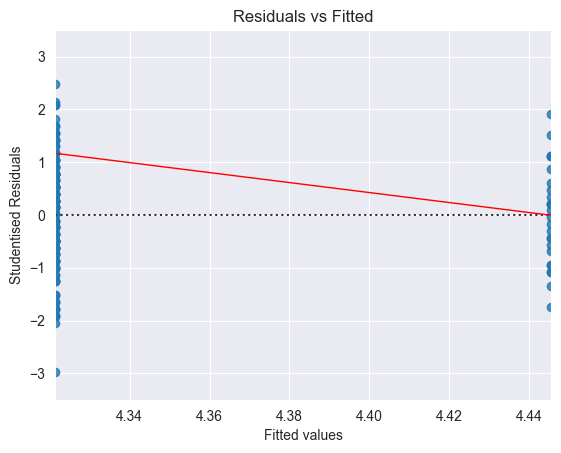

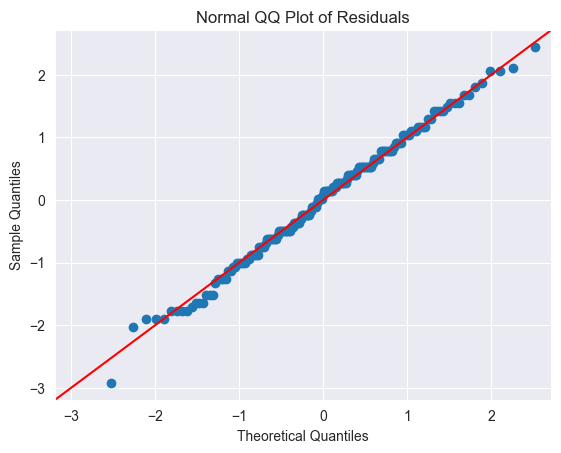

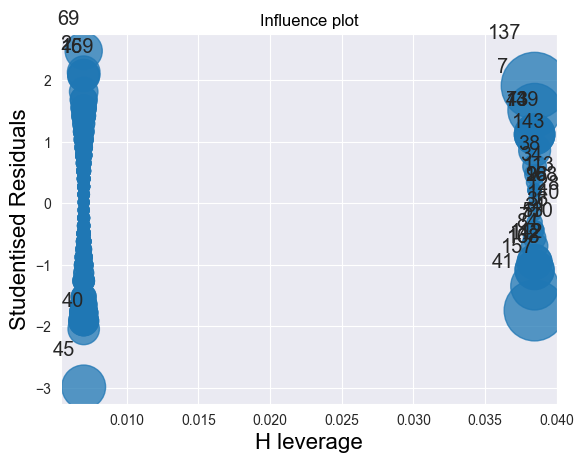

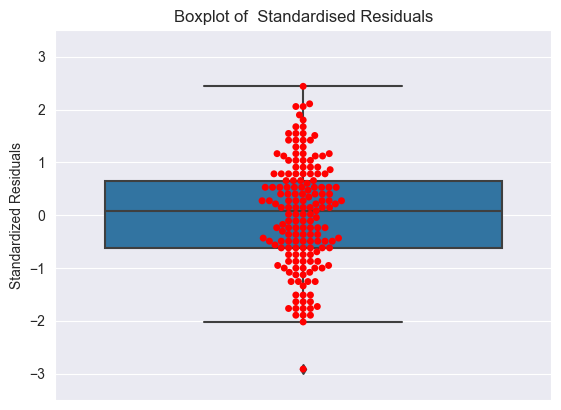

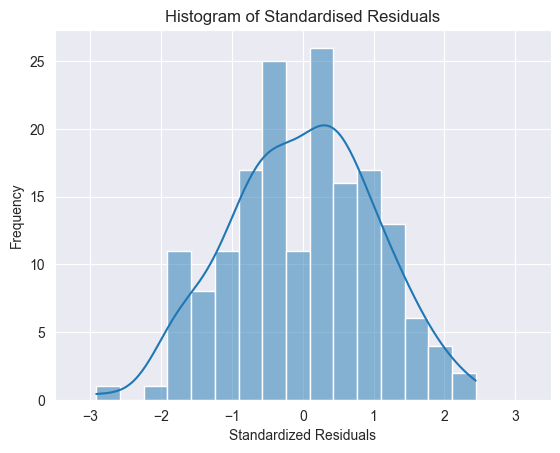

...

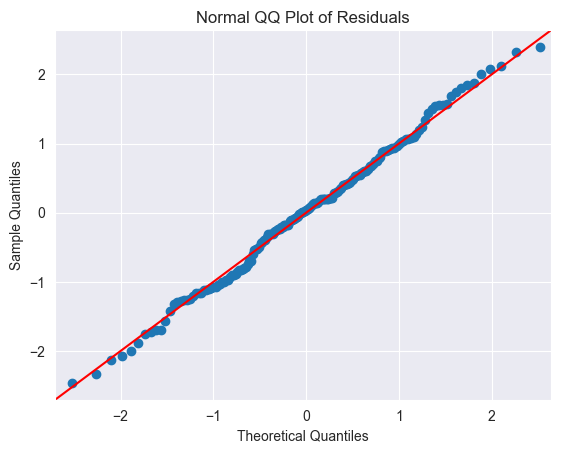

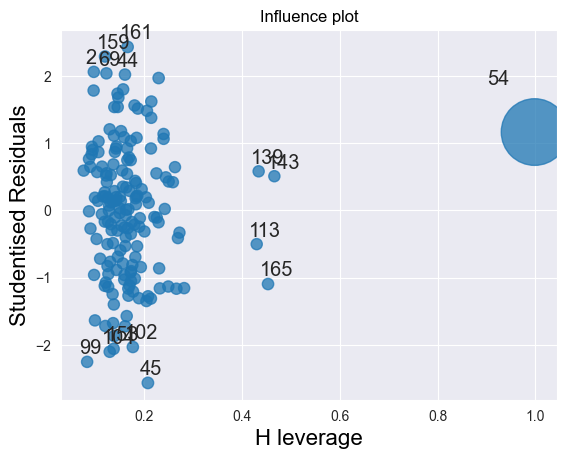

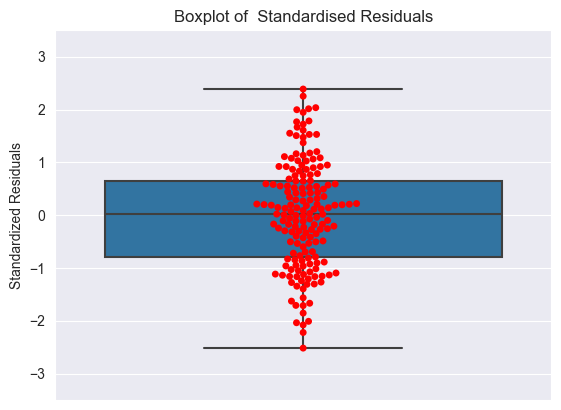

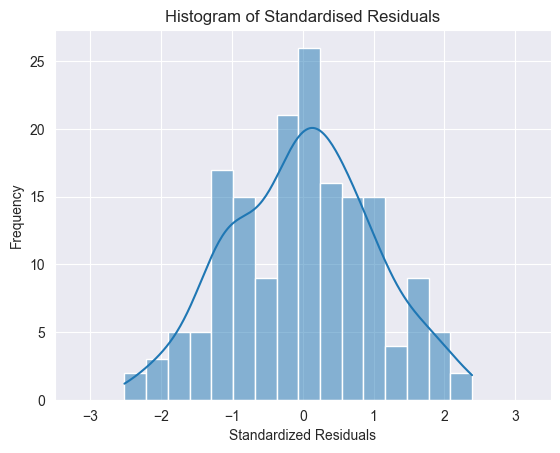

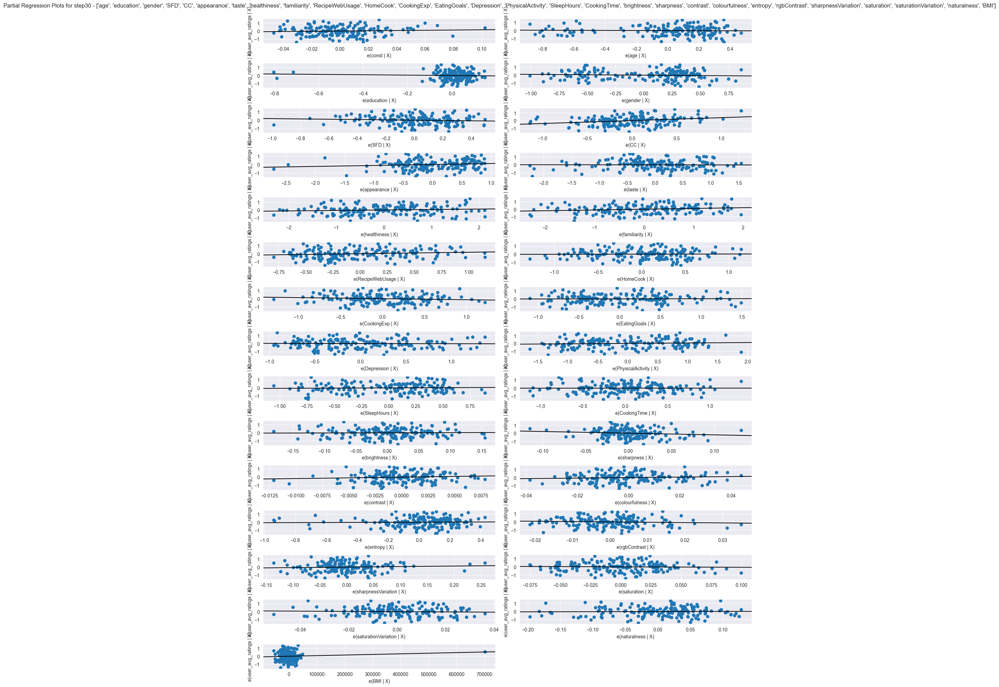

ValueError: Do not have results to export.

In [396]:
model = HLR.HLR_model(diagnostics=True, showfig=True, save_folder='results', verbose=True)
model_results, reg_models = model.run(X=X, X_names=X_names, y=y)
model.save_results(filename='./results.txt', show_results=True)

In [398]:
model_results.to_csv('./csv/results_hlm.csv', index=False)

### Basic  image features HLR

In [134]:
x=x_basic_features 

In [138]:
X = [
      x[['brightness']], 
      x[['brightness','sharpness']], 
      x[['brightness','sharpness', 'contrast']],
      x[['brightness','sharpness', 'contrast', 'colourfulness']], 
      x[['brightness','sharpness', 'contrast', 'colourfulness', 'entropy']], 
      x[['brightness','sharpness', 'contrast', 'colourfulness', 'entropy','rgbContrast']], 
      x[['brightness','sharpness', 'contrast', 'colourfulness', 'entropy','rgbContrast','sharpnessVariation']], 
      x[['brightness','sharpness', 'contrast', 'colourfulness', 'entropy','rgbContrast','sharpnessVariation','saturation']], 
      x[['brightness','sharpness', 'contrast', 'colourfulness', 'entropy','rgbContrast','sharpnessVariation','saturation','saturationVariation']], 
      x[['brightness','sharpness', 'contrast', 'colourfulness', 'entropy','rgbContrast','sharpnessVariation','saturation','saturationVariation','naturalness']], 
      
      ]

X_names =[
      ['brightness'], 
      ['brightness','sharpness'], 
      ['brightness','sharpness','contrast'],
      ['brightness','sharpness','contrast','colourfulness'], 
      ['brightness','sharpness','contrast','colourfulness','entropy'], 
      ['brightness','sharpness','contrast','colourfulness','entropy','rgbContrast'], 
      ['brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation'], 
      ['brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation'], 
      ['brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation','saturationVariation'], 
      ['brightness','sharpness','contrast','colourfulness','entropy','rgbContrast','sharpnessVariation','saturation','saturationVariation','naturalness']]


In [139]:
y_basic_features = pd.DataFrame(y_basic_features)

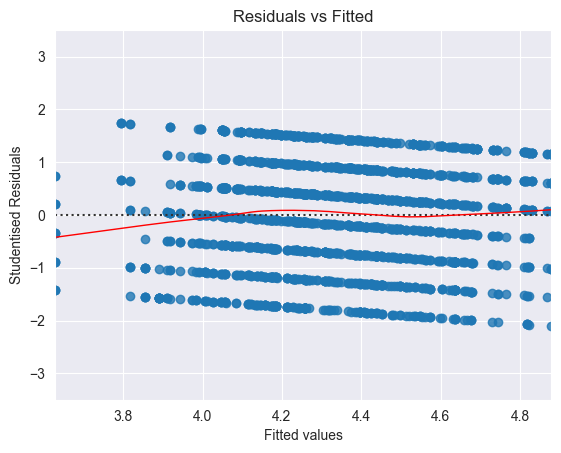

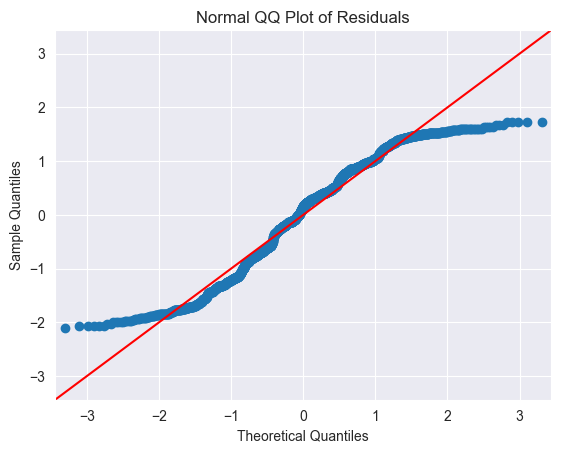

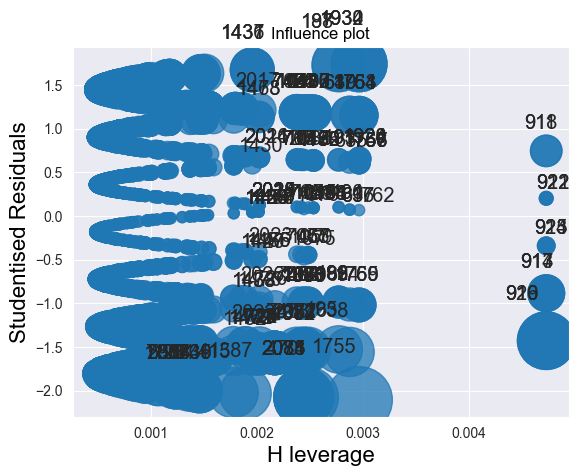

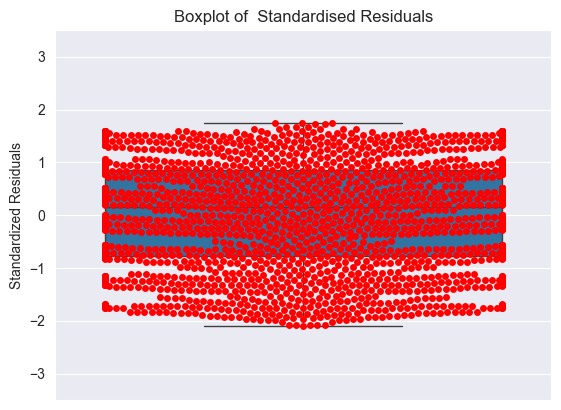

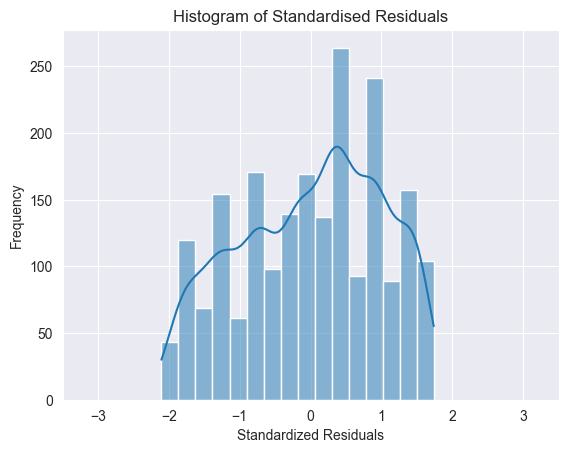

...

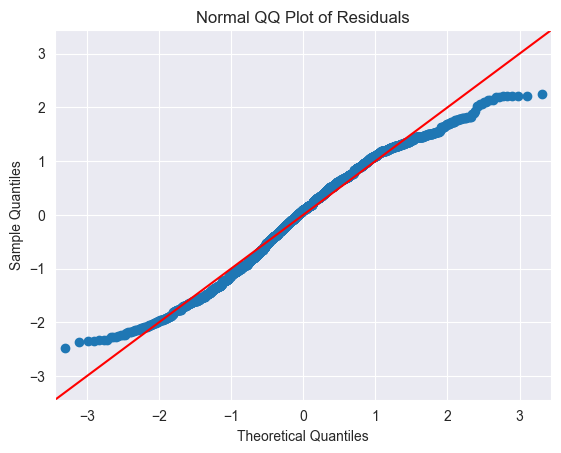

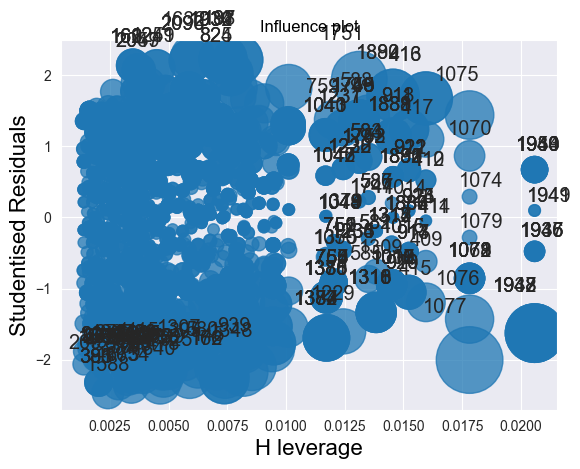

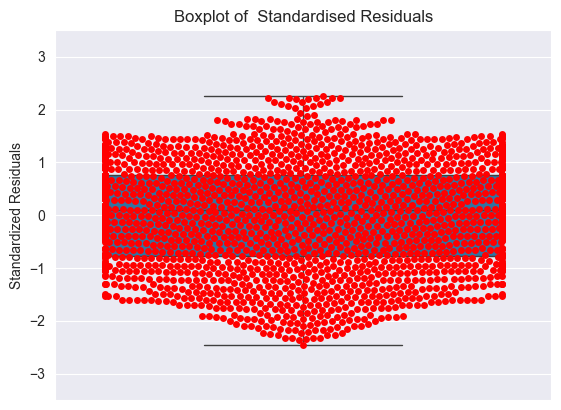

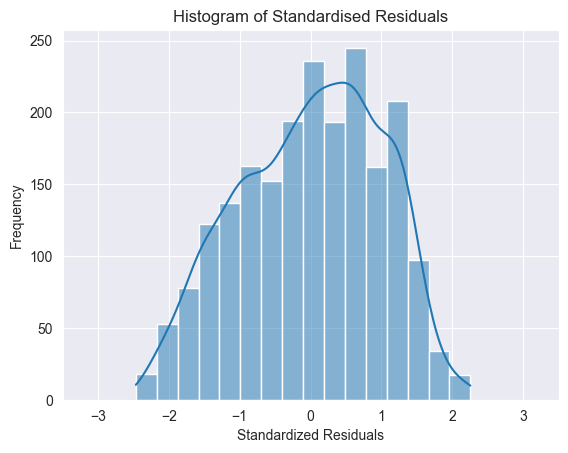

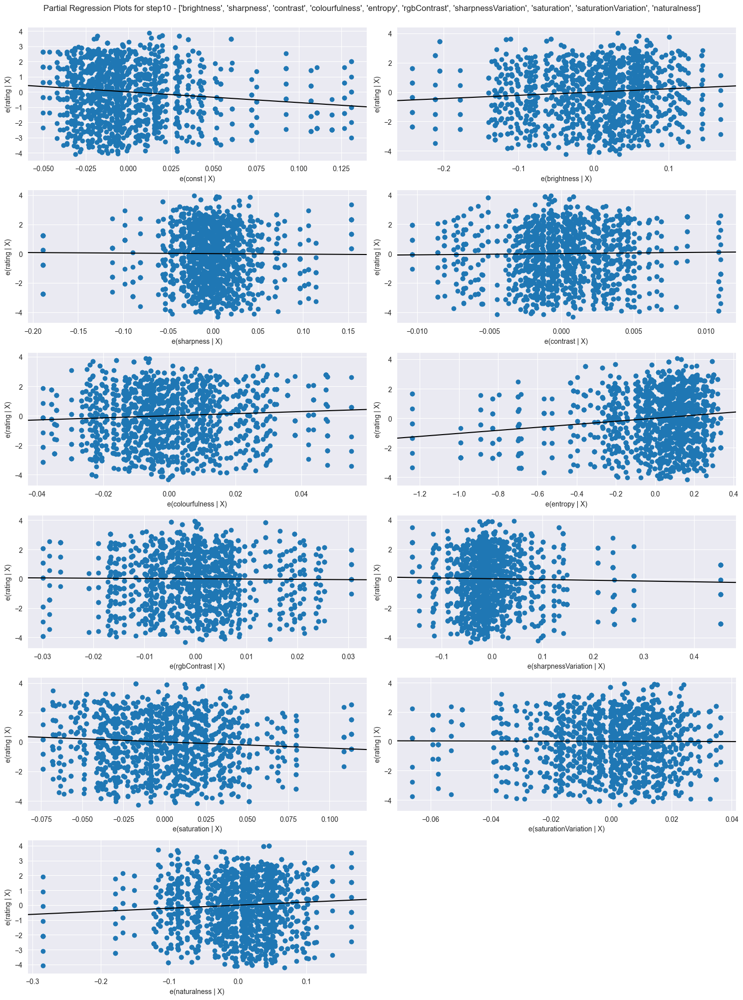

In [140]:
model_basic_features = HLR.HLR_model(diagnostics=True, showfig=True, save_folder='results', verbose=True)
model_results, reg_models = model_basic_features.run(X=X, X_names=X_names, y=y_basic_features)

In [142]:
model_results.to_csv('./basic_features_HRL.csv', index=False)

### Clip Features

In [192]:
clip_features = pd.read_csv('./Clip_features.csv')
clip_features.shape

(254, 769)

In [194]:
clip_features.head()

,recipes,0,1,2,3,4,5,6,7,8,...,758,759,760,761,762,763,764,765,766,767
0,Grilled Eggplant Rollups.jpg,0.69088,0.035062,-0.177470,-0.232540,-0.83650,0.89640,0.471200,0.10001,0.786490,...,0.55995,0.44952,-0.15646,0.067636,0.70147,-0.390540,0.678470,0.066644,0.841380,-0.024708
1,Horseradish Cream Cheese Deviled Eggs.jpg,0.90832,0.689980,0.052422,-0.131300,-0.92119,0.07876,0.273060,0.29641,0.192100,...,0.27330,-0.16348,-0.98410,0.053550,-0.43202,-0.509790,-0.277640,0.270640,0.371170,0.438550
2,Raw Hummus.jpg,0.32288,0.335060,-0.171360,0.115610,-0.77947,0.75050,0.086516,-0.72678,-0.012890,...,0.44698,0.41366,-0.37271,0.213400,0.38104,-0.083492,-0.091158,0.054033,-0.079369,0.545140
3,Bacon Stuffed Mushrooms.jpg,0.83722,-0.112220,-0.405020,0.235390,-0.36638,2.11180,0.098653,1.03480,0.142550,...,0.12008,0.38843,-0.68409,-0.207180,0.18568,-0.314630,0.133800,0.313210,0.302760,0.583710
4,Buffalo Chicken Stuffed Shells.jpg,0.98792,-0.064977,-0.117320,0.022904,-0.46354,0.56110,0.481130,0.18418,-0.032861,...,0.40207,0.47207,-0.97152,-0.312430,-0.69759,-0.241380,-1.037000,0.040592,0.368010,0.042361


In [215]:
image_features_all_user[['user_avg_ratings', 'recipes']]

,user_avg_ratings,recipes
0,5.083333,Moist Holiday Honeycake
1,4.250000,Moist Holiday Honeycake
2,4.000000,Moist Holiday Honeycake
3,5.000000,Moist Holiday Honeycake
4,3.333333,Moist Holiday Honeycake
...,...,...
2104,4.916667,Broccoli Salad
2105,4.666667,Broccoli Salad
2106,5.166667,Broccoli Salad
2107,3.583333,Broccoli Salad


In [214]:
image_features_all_user.columns

Index(['id_x', 'age', 'country', 'education', 'gender', 'person', 'FK_9',
       'FK_10', 'FK_11', 'FK_12', 'CS_9', 'CS_10', 'CS_11', 'CS_12', 'CS_13',
       'CS_14', 'SFD', 'CC', 'sfd_level', 'cc_level', 'rating', 'recipes',
       'judging', 'id_y', 'appearance', 'taste', 'healthiness', 'familiarity',
       'Height', 'Weight', 'RecipeWebUsage', 'HomeCook', 'CookingExp',
       'EatingGoals', 'Depression', 'PhysicalActivity', 'SleepHours',
       'CookingTime', 'user_avg_ratings', 'brightness', 'sharpness',
       'contrast', 'colourfulness', 'entropy', 'rgbContrast',
       'sharpnessVariation', 'saturation', 'saturationVariation',
       'naturalness', 'attractiveness'],
      dtype='object')

In [399]:
remove.to_csv('./removed.csv', index=False)

## World Cloud 

In [12]:
import pandas as pd
import matplotlib.pyplot as plt

In [13]:
# judgment.to_csv('test.csv', index=False)
judgment = pd.read_csv('test.csv')
judgment = judgment[["judging", "rating"]]

In [14]:
from wordcloud import WordCloud, STOPWORDS 
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize 
import nltk
nltk.download('punkt')
from PIL import ImageDraw

[nltk_data] Downloading package punkt to /Users/ayoub/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [118]:
def clean_text_data(text_data):
    word_list = []
    for val in text_data:
        # print("-------->",val)
        text = str(val)
        text = text.lower()
        tokens = word_tokenize(text)
        # remove the word
        tokens = nltk.pos_tag(tokens)
        # print(tokens)
        for l in tokens:
            if l[1] == "NN" or l[1] == "NNS" or l[1] == "NNP":
                word_list.append(l[0])
    return(word_list)

In [578]:
def create_cloud_graph(string):
    # stopwords= set(STOPWORDS)|{'skirt', 'blouse','dress','sweater', 'shirt','bottom', 'pant', 'pants' 'jean', 'jeans','jacket', 'top', 'dresse', 'looked', 'look', 'looks'}
    s = " "
    ww = s.join(string)
    
    
    x, y = np.ogrid[:300, :300]
    mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
    mask = 255 * mask.astype(int)
    
    
    # _, _, text_width, text_height = ImageDraw.Draw(image).textbbox((0, 0), your_text, font=your_font)
    
    
    wordcloud = WordCloud(background_color='white', stopwords = stopwords.words('english'), colormap="copper", width=1600, height=800,collocations=False).generate(ww)
    
    plt.figure( figsize=(20,10), facecolor='k')
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=0)
    plt.show()

In [504]:
## attractive
attractive_text = judgment.loc[judgment.rating > 4]
# attractive_text[['judging']]


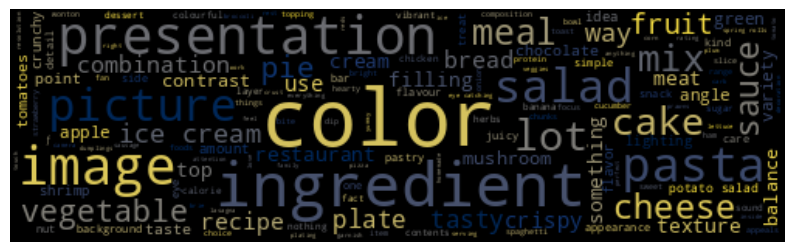

In [414]:
Attrac_rating = clean_text_data(attractive_text.judging)
attract_text = []

for i in Attrac_rating:
    if i in ['i','look', 'nice', 'bit','option', 'look', 'looks','food', 'quality','photo', 'dish']:
        pass
    elif i=='colour' or i == 'colours' or i == 'colors':
        i = 'color'
        attract_text.append(i)
    else:
        attract_text.append(i)
    
create_cloud_graph(attract_text)
# Attrac_rating 

In [415]:
attract_text_df =  pd.DataFrame(attract_text,columns=['Term'])


In [416]:
att_term  = attract_text_df.Term.value_counts().reset_index().to_csv('attractive_Term.csv', index=False)

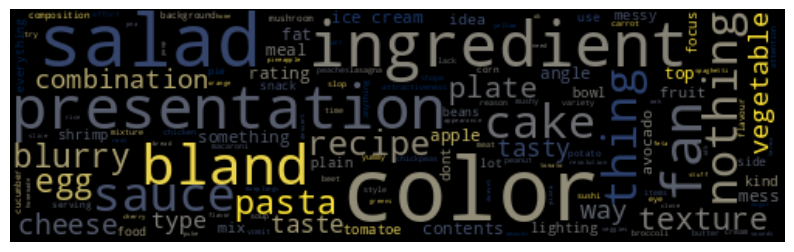

In [417]:
## attractive
unnatctive_text = judgment.loc[judgment.rating <= 4]
unnarac_rating = clean_text_data(unnatctive_text.judging)

uarac_rating = []

for i in unnarac_rating:
    if i in ['i','look', 'nice', 'bit','option', 'look', 'looks','food','image', 'quality', 'dish','picture', 'photo', 'someone' , 'ideacomposition']:
        pass
    elif i=='colour' or i == 'colours' or i == 'colors':
        i = 'color'
        uarac_rating.append(i)
    else:
        uarac_rating.append(i)
    


create_cloud_graph(uarac_rating)

In [418]:
unattract_text_df =  pd.DataFrame(uarac_rating, columns=['Term'])

In [419]:
unn_term = unattract_text_df.Term.value_counts().reset_index().to_csv('unnattractive_Term.csv', index=False)

In [420]:
unnatctive_text.to_csv('./Judgment_unnatrac.csv', index=False)

In [405]:
attractive_text.to_csv('./Judgment_atrac.csv', index=False)

# Filtering word for appearance

In [406]:
appearance_list = ["Tempt","Entice","Sizzle","Grill","Roast","Bake","Broil","Simmer","Saute","Fry","Boil","Steam","Stew","Garnish","Plate","Arrange","Decorate","Present","Sprinkle","Drizzle","Pour","Glaze","Melt","Layer","Stack","Pile","Stuff","Roll","Fold","Toss","Mix","Blend","Whip","Beat","Knead","Cut","Slice","Dice","Julienne","Grate","Shred","Chop","Carve","Grill","Barbecue","Smoke","Infuse","Marinate","Season","Spice","Flavor","Taste","Sample","Smell","Sniff","Savor","Devour","Munch","Crunch","Nibble","Chew","Swallow","Taste-test","Devour","Enjoy","Relish","Feast","Indulge","Nourish","Satiate","Digest","Consume","Inhale","Gobble","Guzzle","Quench","Stir","Stir-fry","Poach","Blanch","Roast","Glaze","Caramelize","Roast","Grill","Broil","Smoke","Steam","Toast","Season","Spice","Sauce","Dress","Douse","Dip","Dunk","Slather","Brush","Spritz","Soak","Infuse","Soak","Bathe","Drown","Bathe","Coat","Glaze","Cover","Wrap","Smother","Envelop","Drape","Frost","Ice","Dust","Sprinkle","Garnish","Adorn","Bedeck","Ornament","Gild","Trim","Cluster","Pile","Arrange","Assemble","Organize","Construct","Stack","Layer","Spread","Display","Show","Exhibit","Showcase","Array","Set","Lay","Position","Place","Install","Deploy","Present","Feature","Highlight","Spotlight","Flaunt","Parade","Model","Flaunt","Flourish","Accentuate","Illuminate","Illuminate","Sparkle","Shimmer","Glisten","Gleam","Glint","Shine","Radiate","Reflect","Beam","Twinkle","Flicker","Bedazzle","Dazzle","Bedeck","Adorn","Embellish","Ornament","Decorate","Grace","Enhance","Enrich","Elevate","Upgrade","Refine","Prettify","Beautify","Modify","Transform","Change","Alter","Adapt","Customize","Tailor","Revise","Revamp","Renew","Refresh","Update","Upgrade","Innovate","Experiment","Explore","Venture","Probe","Investigate","Discover","Appetizing","Palatable","Mouthwatering","Delectable","Scrumptious","Luscious","Delicious","Gourmet","Savory","Aesthetic","Colorful","Vibrant","Tempting","Appealing","Elegant","Artful","Beautiful","Plated","Presentation","Exquisite","Tasty","Flavorful","Rich","Decadent","Fresh","Wholesome","Sumptuous","Culinary","Unique","Artisanal","Rustic","Homemade","Organic","Fragrant","Juicy","Zesty","Piquant","Hearty","Crispy","Crunchy","Velvety","Melt-in-your-mouth","Satisfying","Plump","Fluffy","Spongy","Bubbly","Smooth","Silky","Zingy","Divine","Toothsome","Homely","Robust","Exotic","Seasoned","Infused","Tender","Creamy","Harvested","Locally-sourced","Perfect","Balanced","Toothsome","Satisfying","Rustic","Craveable","Delightful","Homely","Scenic","Appealing","Robust","Flavorsome","Appealing","Unique","Fusion","Umami-rich","Handcrafted","Nutty","Mouth-coating","Harmonious","Satisfying","Vivid","Elegant","Infused","Sumptuous","Appetite-stimulating","Intricate","Appealing","Inviting","Bold","Sharp","Mild","Rich","Dynamic","Exquisite","Scrumptious","Artful","Palate-pleasing","Crispy","Creamy","Zesty","Plentiful","Savory","Flavorful","Homely","Nutrient-rich","Flaky","Marvelous","Tempting","Wholesome","Irresistible","Mouth-coating","Scenic","Culinary","Bold","Flaky","Aromatic","Texture-rich","Fresh","Hearty","Fresh","Hearty","Inviting","Culinary","Robust","Fragrant","Delectable","Aesthetic","Zesty","Tasty","Culinary","Scenic","Fresh","Irresistible","Flavorful","Robust","Sumptuous","Savory","Rustic","Gourmet","Homely","Palate-pleasing","Elegant","Scrumptious","Wholesome","Aesthetic","Crispy","Velvety","Delightful","Appealing","Tempting","Exquisite","Colorful","Vibrant","Rich","Decadent","Satisfying","Plump","Fluffy","Bubbly","Silky","Zingy","Divine","Toothsome","Homely","Robust","Exotic","Seasoned","Infused","Tender","Creamy","Harvested","Locally-sourced","Perfect","Balanced","Toothsome","Satisfying","Rustic","Craveable","Delightful","Homely","Scenic","Appealing","Robust","Flavorsome","Appealing","Unique","Fusion","Umami-rich","Handcrafted","Nutty","Mouth-coating","Harmonious","Satisfying","Vivid","Elegant","Infused","Sumptuous","Appetite-stimulating", 'look', 'nice', 'bit','option', 'look', 'looks','food', 'quality','photo', 'dish']

remove_nouns = ["Dish","Meal","Cuisine","Plate","Serving","Portion","Snack","Appetizer","Main course","Dessert","Breakfast","Lunch","Dinner","Feast","Banquet","Buffet","Platter","Tray","Course","Recipe","Ingredient","Spice","Herb","Flavor","Taste","Aroma","Scent","Smell","Odor","Bouquet","Zest","Sauce","Condiment","Dressing","Garnish","Topping","Dip","Gravy","Broth","Soup","Stew","Casserole","Roast","Grill","Bake","Fry","Saute","Steam","Boil","Simmer","Stir-fry","Sear","Poach","Blanch","Marinate","Seasoning","Spice","Sweetener","Sugar","Salt","Pepper","Vinegar","Oil","Butter","Cheese","Yogurt","Milk","Cream","Egg","Meat","Poultry","Beef","Chicken","Fish","Seafood","Shellfish","Vegetable","Fruit","Nut","Seed","Grain","Rice","Pasta","Bread","Roll","Bun","Bagel","Pastry","Cake","Pie","Cookie","Biscuit","Muffin","Pancake","Waffle","Crepe","Donut","Candy","Chocolate","Ice cream","Sorbet","Gelato","Sherbet","Popsicle","Sorbet","Jam","Jelly","Preserves","Pickle","Relish","Chutney","Salsa","Ketchup","Mustard","Mayonnaise","Hot sauce","Soy sauce","Teriyaki","Marinade","Dressing","Vinaigrette","Breadstick","Cracker","Chip","Pretzel","Popcorn","Noodle","Dumpling","Sushi","Roll","Burrito","Taco","Sandwich","Wrap","Burger","Pizza","Salad","Caesar","Cobb","Waldorf","Caprese","Guacamole","Hummus","Pesto","Tiramisu","Creme brulee","Truffle","Pudding","Parfait","Custard","Souffle","Mousse","Gratin","Quiche","Frittata","Omelet","Croissant","Baguette","Pita","Flatbread","Focaccia","Naan","Ciabatta","Muffuletta","Brioche","Challah","Panini","Gyro","Pho","Ramen","Udon","Curry","Risotto","Gumbo","Chili","Jambalaya","Paella","Tapas","Fondue","Cassoulet","Ratatouille","Bouillabaisse","Chowder","Bisque","Goulash","Bruschetta","Antipasto","Tapenade","Meze","Dolma","Kebab","Dim sum","Sushi","Tempura","Bento","Ramen","Udon","Bibimbap","Kimchi","Bulgogi", "photo", "food"]

In [407]:
filtred_attactive_appearance = []
appearance_list = list(map(lambda x: x.lower(), appearance_list))
remove_nouns = list(map(lambda x: x.lower(), remove_nouns))

In [408]:
for i in Attrac_rating:
    if i == 'i' or i in remove_nouns:
        pass
    elif i=='colour' or i == 'colours' or i == 'colors':
        i = 'color'
    elif i=='looks' or i == 'look' or i == 'looking':
        i = 'looks'
    # elif i=='ice' or i == 'ice ':
        i = 'ice'
    elif i in appearance_list:
        filtred_attactive_appearance.append(i)

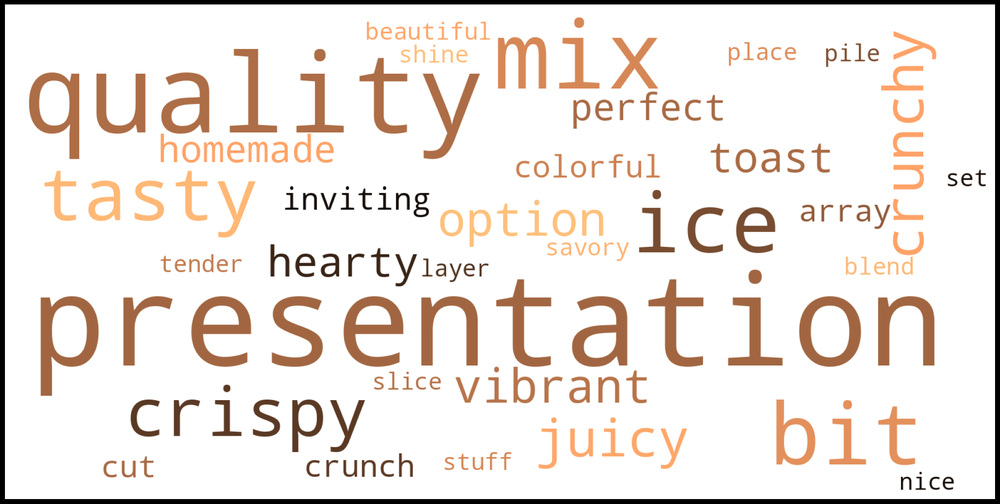

In [579]:
create_cloud_graph(filtred_attactive_appearance)

In [581]:
len(filtred_attactive_appearance)

213

In [582]:
len(Attrac_rating)

2242

In [457]:
filtred_uttactive_appearance = []

In [458]:

for i in unnarac_rating:
    if i == 'i' or i in remove_nouns:
        pass
    elif i=='colour' or i == 'colours' or i == 'colors':
        i = 'color'
    elif i=='looks' or i == 'look' or i == 'looking':
        i = 'looks'
    # elif i=='ice' or i == 'ice ':
        i = 'ice'
    elif i in appearance_list:
        filtred_uttactive_appearance.append(i)

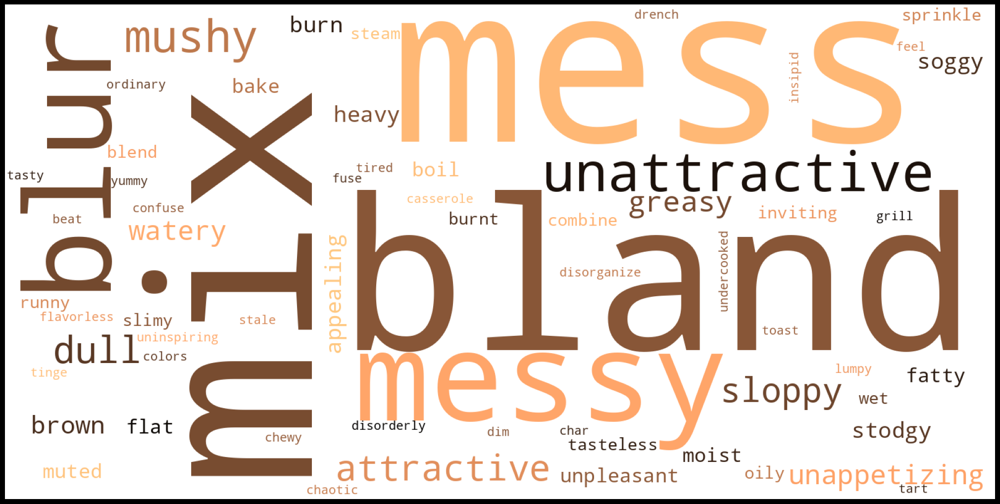

In [580]:
cloud_una_word =  list(map(lambda x: x.strip(), cloud_una_word))
create_cloud_graph(cloud_una_word)

In [522]:
unatractive_list_appearance =  []
for i in cloud_una_word:
    unatractive_list_appearance.append(i.replace(" ", ""))

## Healthiness cloud

In [567]:
 healthy_list = [
     "Wholesome","Nutrient-rich","Nourishing","Healthy","Balanced","Nutritious","Clean","Fresh","Organic","Natural","Satisfying","Energizing","Invigorating","Vitalizing","Guilt-free","Hydrating","Antioxidant-rich","Whole-grain","Low-fat","Low-calorie","High-fiber","Lean","Heart-healthy","Immune-boosting","Energizing","Alkaline","Gluten-free","Dairy-free","Vegan","Vegetarian","Plant-based","Raw","Unprocessed","No additives","Non-GMO","Farm-fresh","Locally sourced","Sustainable","Mindful","Therapeutic","Regenerative","Healing","Fortifying","Enriching","Revitalizing","Strengthening","Renewing","Purifying","Cleansing","Detoxifying","Wholesome","Hearty","Filling","Packed with vitamins","Low-carb","Low-sugar","Balanced","Holistic","Micro-nutrient dense","Pure","Radiant","Robust","Resilient","Spirited","Flourishing","Sustainable","Conscious","Synergetic","Vibrant","Regenerating","Empowering","Nutrient-packed","Potent","Full of goodness","Life-enhancing","Rejuvenating","Thriving","Wholehearted","Sustaining","Good for vitality","green", "veg", "vegetables", "vegetable", "good"
 ]
 
 unhealthy_list = ["Not healthy","Unwholesome","Unhealthy","Non-nutritious","Not beneficial","Not nourishing","Unsalubrious","Not good for health","Harmful","Detrimental","Unsound","Not nutritious","Not healthful","Unfit for consumption","Unbalanced","Deleterious","Unfavorable","Injurious","Unappetizing","Not conducive to well-being","Unbeneficial","Unsanitary","Not wholesome","Not conducive to a healthy lifestyle","Unhygienic","Not conducive to wellness","Unfresh","Not conducive to good health","Not good for your health","Non-organic","Unpure","Not suitable for a healthy diet","Not conducive to a balanced diet","Not conducive to a nutritious diet","Unhealthful","Not conducive to health maintenance","Not conducive to a healthy eating pattern","Not conducive to nutritional well-being","Unhealth-giving","Unfit for human consumption", "unhealthy", "healthiness", "unnecessary", "not good", "good", "bad", "good", "not something",
                  ]

In [584]:
filtred_attactive_healthy = []
healthy_list = list(map(lambda x: x.lower(), healthy_list))
unhealthy_list = list(map(lambda x: x.lower(), unhealthy_list))

In [585]:
for i in Attrac_rating:
    if i in healthy_list:
        filtred_attactive_healthy.append(i)

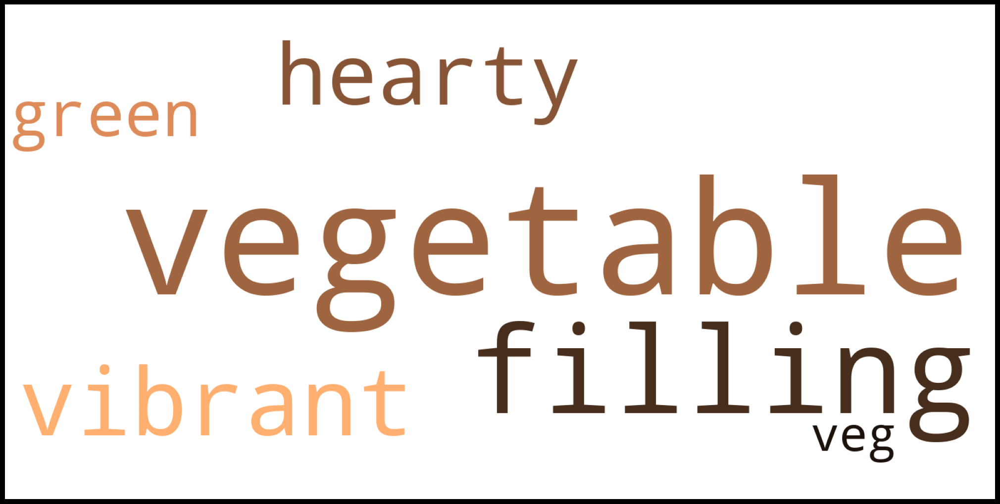

In [586]:
create_cloud_graph(filtred_attactive_healthy)

In [569]:
filtred_unattactive_healthy = []
for i in unnatctive_text.judging:
    for j in unhealthy_list:
        if j in i:
            filtred_unattactive_healthy.append(j)

In [572]:
uneahlhy_cloud = []
for i in filtred_unattactive_healthy:
    if i == "good":
        i= "notgood"
    if i == "something":
        i= "notsomething"
    uneahlhy_cloud.append(i)

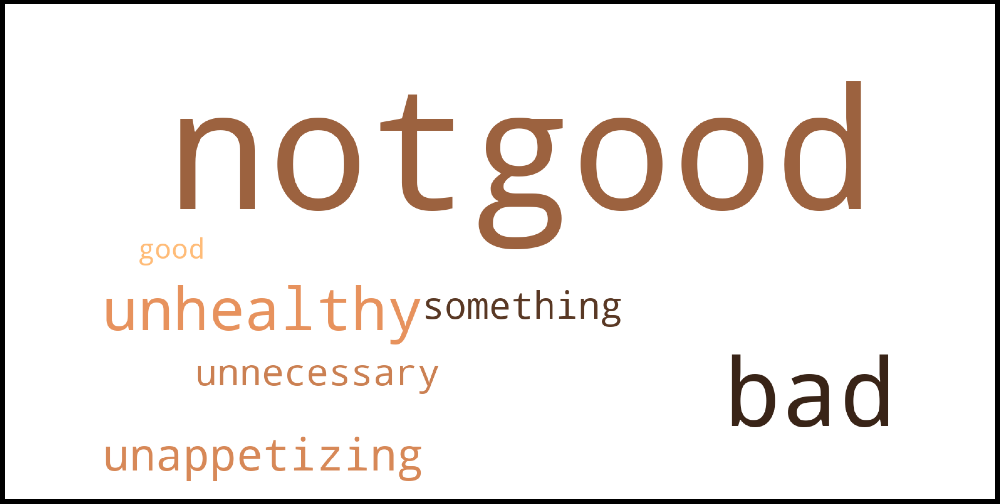

In [587]:
create_cloud_graph(uneahlhy_cloud)